In [1]:
import numpy as np
import xarray as xr
import os
# import cartopy.crs as ccrs
import matplotlib.pyplot as plt
import pandas as pd
import pygmt
import gmt_plot
import sys
sys.path.append('/Volumes/envisat2/SWOT/src/lib_sio/')
sys.path.append('/Volumes/envisat2/SWOT/src/SWOT-OpenToolkit-main/src/')
# sys.path.append('/cryosat2/SWOT/src/lib_sio/')
import swot_ssh_utils as swot
import swot_sio_utils as sio
import scipy.signal
import random
import scipy.stats as st

In [5]:
# !{sys.executable} -m pip install openpyxl

### read VGG

In [109]:
vgg_file = xr.open_dataset("/Volumes/envisat2/SWOT/src/sandwell/grid_swot/out_stack_plot/vgg_swot.grd")
old_vgg_file = xr.open_dataset("/Volumes/envisat2/SWOT/src/sandwell/grid_swot/curv_32.1.nc")

pygmt.grdfilter(
    grid="/Volumes/envisat2/SWOT/src/sandwell/grid_swot/out_stack_plot/vgg_swot.grd",
    filter="g12",
    distance="4",
    region=[-180, 180, -80, 80],
    spacing=0.01666666666,
    outgrid="vgg_smooth.grd",
)

In [2]:
# vgg_file = xr.open_dataset("/Volumes/envisat2/SWOT/src/sandwell/grid_swot/out_stack_median/vgg_swot.grd")
vgg_file = xr.open_dataset("vgg_smooth.grd")
shade_vgg1 = pygmt.grdgradient(grid=xr.DataArray(vgg_file.z, coords=(vgg_file.lat, vgg_file.lon)), azimuth = 50, normalize="t.5")
shade_vgg2 = pygmt.grdgradient(grid=xr.DataArray(vgg_file.z, coords=(vgg_file.lat, vgg_file.lon)), azimuth = 20, normalize="t.5")

vgg_SWIR = vgg_file.sel(lon=slice(42, 62), lat=slice(-42, -31.4))
# shade_SWIR = pygmt.grdgradient(grid=xr.DataArray(vgg_SWIR.z, coords=(vgg_SWIR.lat, vgg_SWIR.lon)), radiance=[10, 90])
shade_SWIR = pygmt.grdgradient(grid=xr.DataArray(vgg_SWIR.z, coords=(vgg_SWIR.lat, vgg_SWIR.lon)), azimuth = 10, normalize="t.5")

vgg_SEIR = vgg_file.sel(lon=slice(62.5, 87.5), lat=slice(-45, -32))
# shade_SEIR = pygmt.grdgradient(grid=xr.DataArray(vgg_SEIR.z, coords=(vgg_SEIR.lat, vgg_SEIR.lon)), radiance=[30, 60])
shade_SEIR = pygmt.grdgradient(grid=xr.DataArray(vgg_SEIR.z, coords=(vgg_SEIR.lat, vgg_SEIR.lon)), azimuth=45, normalize="t.5")

vgg_EPR = vgg_file.sel(lon=slice(-120, -105), lat=slice(-22, -12.5))
# shade_EPR = pygmt.grdgradient(grid=xr.DataArray(vgg_EPR.z, coords=(vgg_EPR.lat, vgg_EPR.lon)), radiance=[100, 60])
shade_EPR = pygmt.grdgradient(grid=xr.DataArray(vgg_EPR.z, coords=(vgg_EPR.lat, vgg_EPR.lon)), azimuth=100, normalize="t.5")

### read plate boundaries

In [8]:
%%sh
# gmt kml2gmt Plate_Interface.kml -V > Plate_Interface.xyz


kml2gmt [INFORMATION]: Processing input KML data
kml2gmt [INFORMATION]: Writing Data Table to Standard Output stream
kml2gmt [INFORMATION]: Processing Plate_Interface.kml
kml2gmt [INFORMATION]: Found 1180 features with selected geometry


### global maps

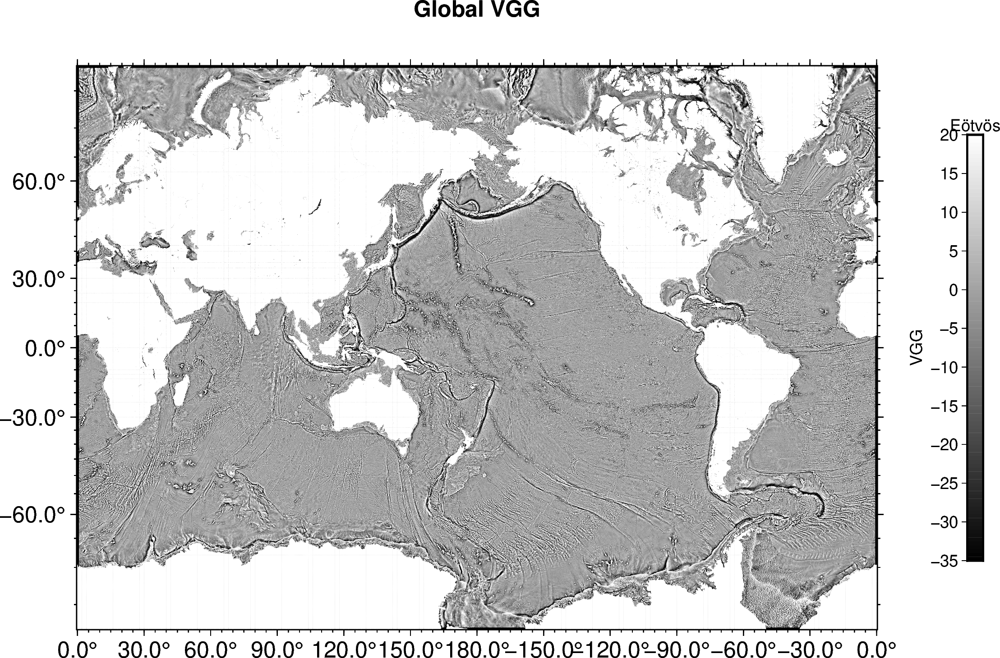

In [10]:
fig = pygmt.Figure()
pygmt.config(FORMAT_GEO_MAP="ddd.x", MAP_FRAME_TYPE="plain", FONT="12p")
pygmt.makecpt(cmap="gray", series=[-35, 20, 0.5], background='o')
fig.grdimage(
    grid = xr.DataArray(vgg_file.z, coords=(vgg_file.lat, vgg_file.lon)),
    shading=shade_vgg1,
    projection="M15c",
    region = [0, 360, -77.6, 77.6],
    frame=["WSenrt+tGlobal VGG", "xa30f5", "ya30f5"],
    cmap = True,
    )


fig.coast(land="white", resolution="h")
fig.colorbar(position="JML+o-17c/0c+w8c/0.3c", frame=["xa5f5+lVGG", "y+lEötvös"])

fig.savefig("global_vgg_gray.pdf", dpi=300)
fig.show()

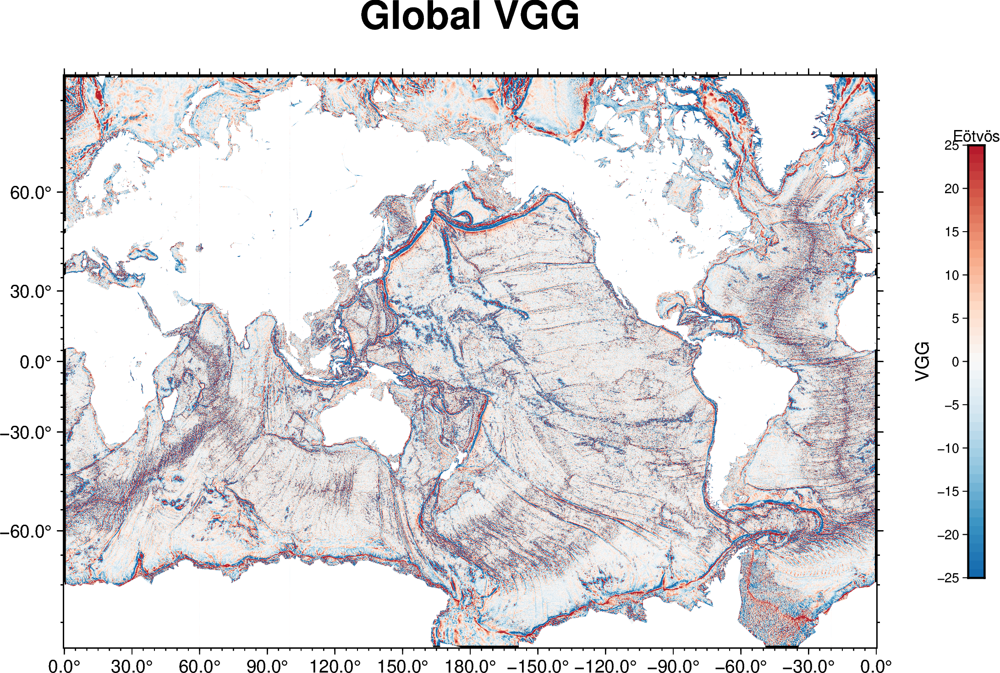

In [96]:
fig = pygmt.Figure()
pygmt.config(FORMAT_GEO_MAP="ddd.x", MAP_FRAME_TYPE="plain")
pygmt.makecpt(cmap="colors.cpt", series=[-25, 25, 1], background='o')
fig.grdimage(
    grid = xr.DataArray(vgg_file.z, coords=(vgg_file.lat, vgg_file.lon)),
    shading=shade_vgg1,
    projection="M15c",
    region = [0, 360, -77.6, 77.6],
    frame=["WSenrt+tGlobal VGG", "xa30f5", "ya30f5"],
    cmap = True,
    )

fig.coast(land="white")
fig.colorbar(position="JML+o-17c/0c+w8c/0.3c", frame=["xa5f5+lVGG", "y+lEötvös"])

fig.savefig("global_vgg_polar.pdf", dpi=300)
fig.show()

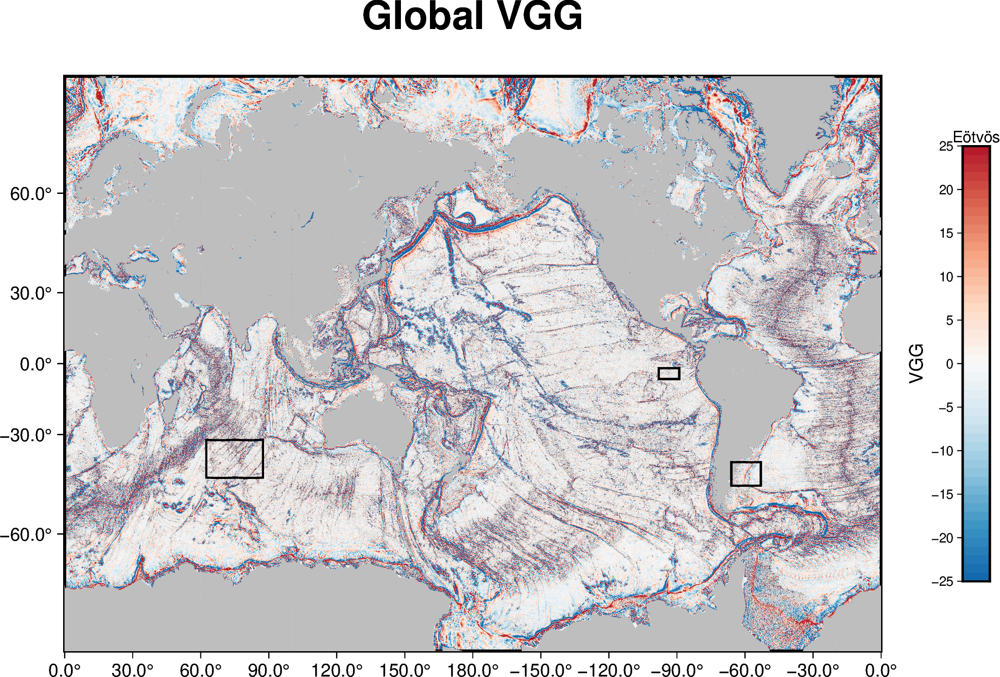

In [4]:
fig = pygmt.Figure()
pygmt.config(FORMAT_GEO_MAP="ddd.x", MAP_FRAME_TYPE="plain")
pygmt.makecpt(cmap="colors.cpt", series=[-25, 25, 1], background='o')
fig.grdimage(
    grid = xr.DataArray(vgg_file.z, coords=(vgg_file.lat, vgg_file.lon)),
    shading=shade_vgg1,
    projection="M15c",
    region = [0, 360, -77.6, 77.6],
    frame=["WSrt+tGlobal VGG", "xa30", "ya30"],
    cmap = True,
    )
fig.coast(land="gray")
fig.plot(
    x=[62.5,75,87.5,87.5,75,62.5, 62.5],
    y=[-45,-45,-45,-32,-32,-32,-45],
    pen="1p,black",
)

fig.plot(
    x=[-98,-89,-89,-98,-98],
    y=[-6.8,-6.8,-2,-2,-6.8],
    pen="1p,black",
)


fig.plot(
    x=[-66,-60,-53,-53,-60,-66,-66],
    y=[-47.5,-47.5,-47.5,-40,-40,-40,-47.5],
    pen="1p,black",
)
fig.colorbar(position="JML+o-17c/0c+w8c/0.3c", frame=["xa5f5+lVGG", "y+lEötvös"])

fig.savefig("global_vgg.pdf", dpi=300)
fig.show()

In [ ]:
fig = pygmt.Figure()
pygmt.config(FORMAT_GEO_MAP="ddd.x", MAP_FRAME_TYPE="plain")
pygmt.makecpt(cmap="colors.cpt", series=[-25, 25, 1], background='o')
fig.grdimage(
    grid = xr.DataArray(vgg_file.z, coords=(vgg_file.lat, vgg_file.lon)),
    shading=shade_vgg1,
    projection = "G-170/20/15c",
    region="g",
    frame="g",
    cmap = True,
    )
fig.coast(land="gray")

fig.shift_origin(xshift="18c")
fig.grdimage(
    grid = xr.DataArray(vgg_file.z, coords=(vgg_file.lat, vgg_file.lon)),
    shading=shade_vgg2,
    projection = "G50/-40/15c",
    region="g",
    # frame=["Wsrt+tVGG_SWIR", "xa2", "ya2"],
    frame="g",
    cmap = True,
    )
fig.coast(land="gray")
fig.savefig("global_vgg.png", dpi=300)
fig.show()

### abyssal hills

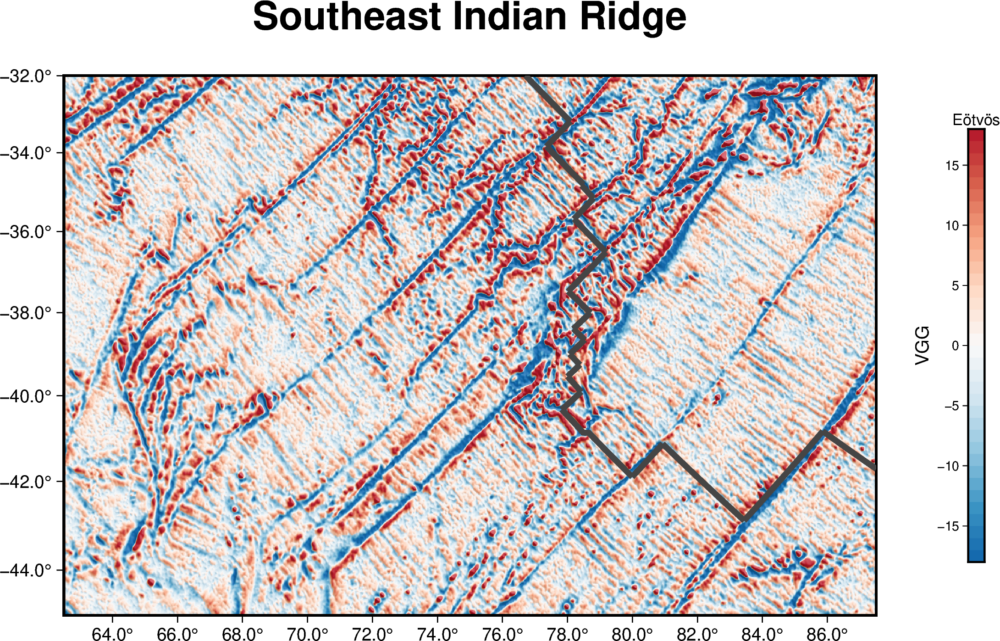

In [3]:
fig = pygmt.Figure()
pygmt.config(FORMAT_GEO_MAP="ddd.x", MAP_FRAME_TYPE="plain")

fig.shift_origin(xshift="17c")
pygmt.makecpt(cmap="colors.cpt", series=[-18, 18, 1], background='o')
fig.grdimage(
    grid = xr.DataArray(vgg_SEIR.z, coords=(vgg_SEIR.lat, vgg_SEIR.lon)),
    shading = shade_SEIR,
    projection="M15c",
    region = [62.5, 87.5, -45, -32],
    frame=["WSrt+tSoutheast Indian Ridge", "xa2", "ya2"],
    cmap = True,
    )
fig.plot(
    data = 'Plate_Interface.xyz',
    pen="3p,gray27,solid",
    )

fig.colorbar(position="JML+o-17c/0c+w8c/0.3c", frame=["xa5f5+lVGG", "y+lEötvös"])
# fig.savefig("SWOT_Abyssal_hills.pdf", dpi=600)
fig.show()

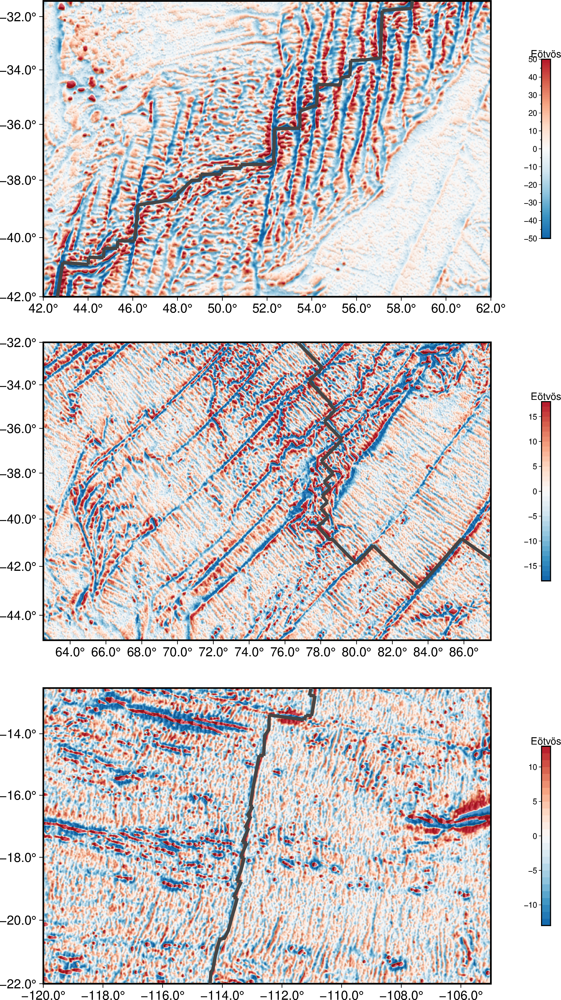

In [20]:
fig = pygmt.Figure()
pygmt.config(FORMAT_GEO_MAP="ddd.x", MAP_FRAME_TYPE="plain", FONT_LABEL="15p,Helvetica,black", FONT_ANNOT="15p")
pygmt.config(FONT_ANNOT_PRIMARY="12p,Helvetica,black")

############################ SWIR ##################################
pygmt.makecpt(cmap="colors.cpt", series=[-50, 50, 1], background='o')
fig.grdimage(
    grid = xr.DataArray(vgg_SWIR.z, coords=(vgg_SWIR.lat, vgg_SWIR.lon)),
    shading = shade_SWIR,
    projection="M15c",
    region = [42, 62, -42, -31.4],
    frame=["WSrt", "xa2", "ya2"],
    cmap = True,
    )
fig.plot(
    data = 'Plate_Interface.xyz',
    pen="3p,gray27,solid"
    )
fig.colorbar(position="JML+o-17c/0c+w6c/0.3c", frame=["xa10f5", "y+lEötvös"])

####################### SEIR ##################################
fig.shift_origin(yshift="-11.5c")
pygmt.makecpt(cmap="colors.cpt", series=[-18, 18, 1], background='o')
fig.grdimage(
    grid = xr.DataArray(vgg_SEIR.z, coords=(vgg_SEIR.lat, vgg_SEIR.lon)),
    shading = shade_SEIR,
    projection="M15c",
    region = [62.5, 87.5, -45, -32],
    frame=["WSrt", "xa2", "ya2"],
    cmap = True,
    )
fig.plot(
    data = 'Plate_Interface.xyz',
    pen="3p,gray27,solid",
    )
fig.colorbar(position="JML+o-17c/0c+w6c/0.3c", frame=["xa5f5", "y+lEötvös"])

############################ EPR ##################################
fig.shift_origin(yshift="-11.5c")
pygmt.makecpt(cmap="colors.cpt", series=[-13, 13, 1], background='o')
fig.grdimage(
    grid =  xr.DataArray(vgg_EPR.z, coords=(vgg_EPR.lat, vgg_EPR.lon)),
    shading = shade_EPR,
    projection="M15c",
    region = [-120, -105, -22, -12.5],
    frame=["WSrt", "xa2", "ya2"],
    cmap = True,
    )
fig.plot(
    data = 'Plate_Interface.xyz',
    pen="3p,gray27,solid",
    )
fig.colorbar(position="JML+o-17c/0c+w6c/0.3c", frame=["xa5f5", "y+lEötvös"])

fig.savefig("Abyssal_hills.png", dpi=300)
fig.show()

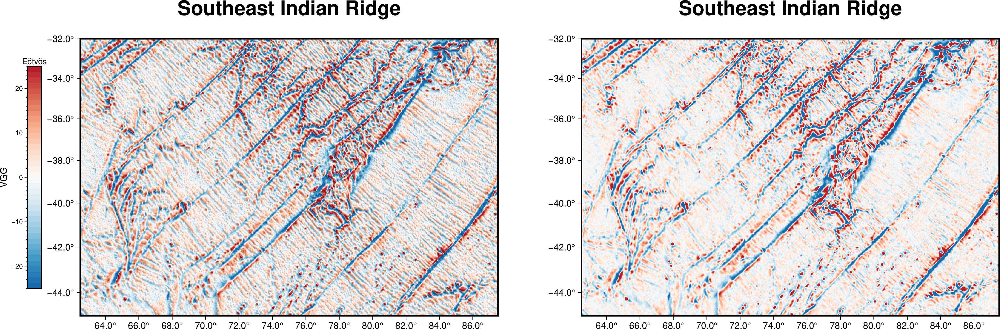

In [4]:
c_min = -25
c_max = 25
vgg_SEIR = vgg_file.sel(lon=slice(62.5, 87.5), lat=slice(-45, -32))
region_size = [62.5, 87.5, -45, -32]
data = xr.DataArray(vgg_SEIR.z, coords=(vgg_SEIR.lat, vgg_SEIR.lon))
ddata = pygmt.grdgradient(grid=data, radiance=[30, 60])

fig = pygmt.Figure()
pygmt.config(FORMAT_GEO_MAP="ddd.x", MAP_FRAME_TYPE="plain")
pygmt.makecpt(cmap="colors.cpt", series=[c_min, c_max, (c_max-c_min)/40.0], background='o')
fig.grdimage(
    grid = data,
    shading = shade_SEIR,
    projection="M15c",
    region = region_size,
    frame=["WSrt+tSoutheast Indian Ridge", "xa2", "ya2"],
    cmap = True,
    )

fig.colorbar(position="JML+o1.4c/0c+w8c/0.5c", frame=["xa10f1+lVGG", "y+lEötvös"])

# --------------- plotting the hillshade map -----------
fig.shift_origin(xshift="18c")

fig.grdimage(
    grid = data,
    projection="M15c",
    region = region_size,
    frame=["WSrt+tSoutheast Indian Ridge", "xa2", "ya2"],
    cmap = True,
    )

fig.savefig("SEIR.png", dpi=300)
fig.show()

### small seamounts

In [21]:
topo_file = xr.open_dataset("/Volumes/envisat2/SWOT/src/sandwell/grid_swot/SYNBATH_V2.0.nc")
sid_file = xr.open_dataset("SID_V2.6.nc")
# vgg_file = xr.open_dataset("/Volumes/envisat2/SWOT/src/sandwell/grid_swot/vgg_swot.grd")

vgg_file = xr.open_dataset("vgg_smooth.grd")
old_vgg_file = xr.open_dataset("/Volumes/envisat2/SWOT/src/sandwell/grid_swot/curv_32.1.nc")

In [45]:
%%sh
gmt grdcut /Volumes/envisat2/SWOT/src/sandwell/grid_swot/SYNBATH_V2.0.nc -R-112.5/-110.5/-19.25/-17.2 -Gtopo_seamounts.grd

In [52]:
pygmt.grdfilter(
    grid="topo_seamounts.grd",
    filter="g12",
    distance="4",
    region=[-112.5,-110.5,-19.25,-17.2],
    spacing=0.0041666667,
    outgrid="topo_seamounts_smooth.grd",
)
topo_seamounts_smooth = xr.open_dataset("topo_seamounts_smooth.grd")


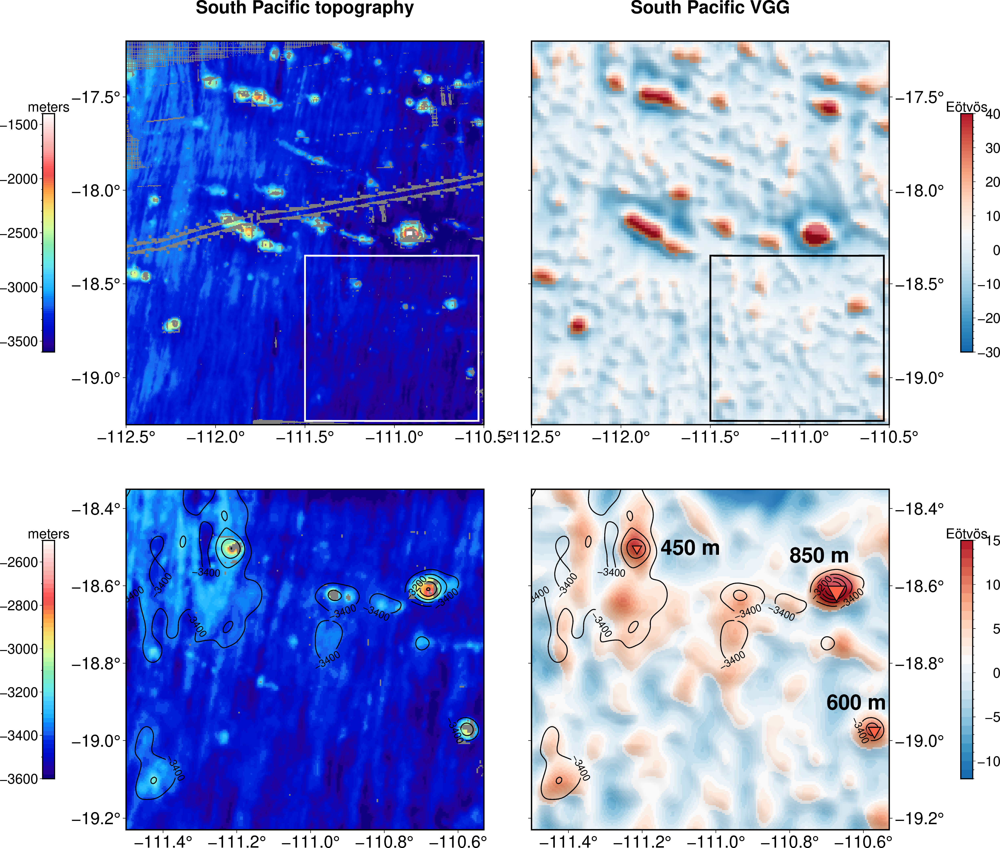

In [65]:
topo_seamounts = topo_file.sel(lon=slice(-112.5, -110.5), lat=slice(-19.25, -17.2))
vgg_seamounts = vgg_file.sel(lon=slice(-112.5, -110.5), lat=slice(-19.25, -17.2))
sid_seamounts = sid_file.sel(x=slice(-112.5, -110.5), y=slice(-19.25, -17.2))

region_size = [-112.5, -110.5, -19.25, -17.2]

shade_vgg = pygmt.grdgradient(grid=xr.DataArray(vgg_seamounts.z, coords=(vgg_seamounts.lat, vgg_seamounts.lon)), azimuth = 20, normalize="t.5")
soundings_seamounts = topo_seamounts.z.values
soundings_seamounts[sid_seamounts.z.values == 0] = np.nan
new_vgg_seamounts = pygmt.grdsample(
    grid=xr.DataArray(vgg_seamounts.z, coords=(vgg_seamounts.lat, vgg_seamounts.lon)), 
    translate = True, spacing=[0.004166666, 0.004166666])
new_shade_vgg = pygmt.grdgradient(grid=xr.DataArray(new_vgg_seamounts.values, coords=(new_vgg_seamounts.y, new_vgg_seamounts.x)), azimuth = 20, normalize="t.5")

fig = pygmt.Figure()
pygmt.config(FORMAT_GEO_MAP="ddd.x", MAP_FRAME_TYPE="plain", FONT_LABEL="15p,Helvetica,black", FONT_ANNOT="20p")
pygmt.config(FONT_ANNOT_PRIMARY="20p,Helvetica,black")
pygmt.makecpt(cmap="haxby", series=[-3600, -1400, 20], background='o',no_bg=False)
fig.grdimage(
    grid = xr.DataArray(soundings_seamounts, coords=(topo_seamounts.lat, topo_seamounts.lon)),
    projection="M15c",
    region = region_size,
    frame=["WSrt+tSouth Pacific topography", "xa0.5", "ya0.5"],
    cmap = True,
    )

fig.colorbar(position="JML+o3.0c/0c+w10c/0.5c", frame=["xa500f100", "y+lmeters"])
fig.plot(
    x=[-111.5,-110.53,-110.53,-111.5,-111.5],
    y=[-19.23,-19.23,-18.35,-18.35,-19.23],
    pen="2p,white",
)

fig.shift_origin(yshift="-17c")
[x,y] = np.meshgrid(topo_seamounts.lon, topo_seamounts.lat)
pygmt.makecpt(cmap="haxby", series=[-3600, -2500, 20], background='o')
fig.grdimage(
    grid = xr.DataArray(soundings_seamounts, coords=(topo_seamounts.lat, topo_seamounts.lon)),
    # shading = shade_SEIR,
    projection="M15c",
    region = [-111.5, -110.53, -19.23, -18.35],
    frame=["WSrt+t", "xa0.2", "ya0.2"],
    cmap = True,
    )
fig.grdcontour(
    grid=xr.DataArray(topo_seamounts_smooth.z, coords=(topo_seamounts_smooth.lat, topo_seamounts_smooth.lon)),
    annotation="200+f12p",
    interval=100,
    pen = "1p,black",
    limit=[-3400, -2800],
)

fig.colorbar(position="JML+o3.0c/0c+w10c/0.5c", frame=["xa200f100", "y+lmeters"])


fig.shift_origin(xshift="17c", yshift="17c")
pygmt.makecpt(cmap="colors.cpt", series=[-30,40, 1], background='o')
# pygmt.makecpt(cmap="gray", series=[-30,30, 1], background='o')

fig.grdimage(
    grid = xr.DataArray(vgg_seamounts.z, coords=(vgg_seamounts.lat, vgg_seamounts.lon)),
    shading = shade_vgg,
    projection="M15c",
    region = region_size,
    frame=["SEwt+tSouth Pacific VGG", "xa0.5", "ya0.5"],
    cmap = True,
    )

fig.colorbar(position="JML+o-18.5c/0c+w10c/0.5c+m", frame=["xa10f2", "y+lEötvös"])
fig.plot(
    x=[-111.5,-110.53,-110.53,-111.5,-111.5],
    y=[-19.23,-19.23,-18.35,-18.35,-19.23],
    pen="2p,black",
)

fig.shift_origin(yshift="-17c")
pygmt.makecpt(cmap="colors.cpt", series=[-12, 15, 1], background='o')
# pygmt.makecpt(cmap="gray", series=[-10, 15, 1], background='o')
fig.grdimage(
    grid = xr.DataArray(new_vgg_seamounts.values, coords=(new_vgg_seamounts.y, new_vgg_seamounts.x)),
    shading = new_shade_vgg,
    projection="M15c",
    region = [-111.5, -110.53, -19.23, -18.35],
    frame=["SEwt+t", "xa0.2", "ya0.2"],
    cmap = True,
    )

# fig.grdcontour(
#     grid=xr.DataArray(vgg_SEIR.z, coords=(vgg_SEIR.lat, vgg_SEIR.lon)),
#     interval=5,  # interval between contours
#     annotation="5+f12p",  # annotate every 5 contours with font size 12p
#     pen="1p,black"  # contour line style
# )

fig.grdcontour(
    grid=xr.DataArray(topo_seamounts_smooth.z, coords=(topo_seamounts_smooth.lat, topo_seamounts_smooth.lon)),
    annotation="200+f12p",
    interval=100,
    pen = "1p,black",
    limit=[-3400, -2800],
)

fig.plot(x=-110.673, y=-18.614, style="i0.85c", pen="1p,black", fill="tomato")
fig.text(text="850 m", x=-110.8, y=-18.52, justify="LM", font="25p,Helvetica-Bold")
fig.plot(x=-111.214, y=-18.504, style="i0.45c", pen="1p,black", fill="tomato")
fig.text(text="450 m", x=-111.15, y=-18.5, justify="LM", font="25p,Helvetica-Bold")
fig.plot(x=-110.570, y=-18.975, style="i0.6c", pen="1p,black", fill="tomato")
fig.text(text="600 m", x=-110.7, y=-18.9, justify="LM", font="25p,Helvetica-Bold")

fig.colorbar(position="JML+o-18.5c/0c+w10c/0.5c+m", frame=["xa5f1", "y+lEötvös"])

fig.savefig("seamounts.png", dpi=600)
fig.show()

In [4]:
%%sh
gmt grdcut vgg_smooth.grd -Gvgg_seamount_SWOT.grd -R-98/-89/-6.8/-2

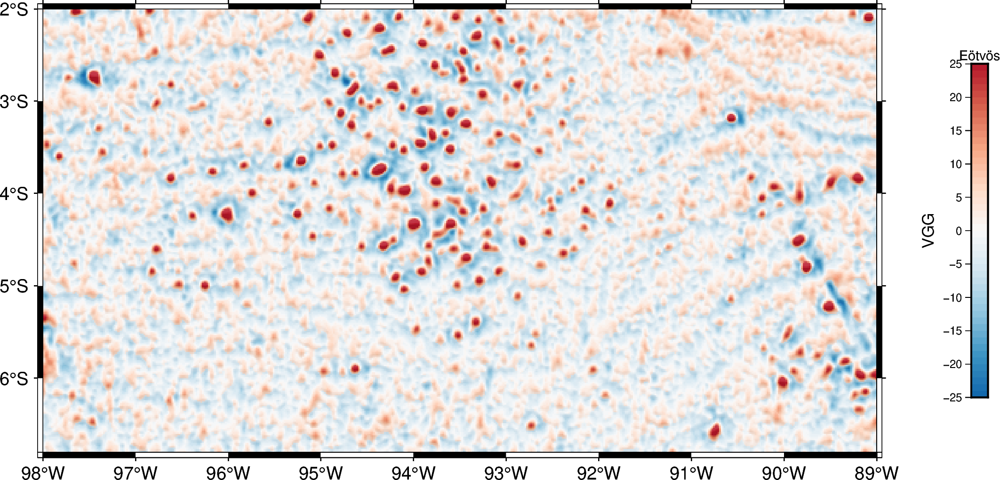

In [3]:
# topo_seamounts = topo_file.sel(lon=slice(-98, -89), lat=slice(-6.8, -2))
vgg_seamounts = vgg_file.sel(lon=slice(-98, -89), lat=slice(-6.8, -2))
shade_vgg = pygmt.grdgradient(grid=xr.DataArray(vgg_seamounts.z, coords=(vgg_seamounts.lat, vgg_seamounts.lon)), azimuth = 0, normalize="t.2")

fig = pygmt.Figure()
pygmt.makecpt(cmap="colors.cpt", series=[-25, 25, 1], background='o')
fig.grdimage(
    grid = xr.DataArray(vgg_seamounts.z, coords=(vgg_seamounts.lat, vgg_seamounts.lon)),
    shading = shade_vgg,
    projection="M15c",
    # region = [-97.8, -92.2, -7, -.5],
    region = [-98, -89, -6.8, -2],
    frame=["WSrt+t", "xa1", "ya1"],
    cmap = True,
    )

fig.colorbar(position="JML+o-17c/0c+w6c/0.3c", frame=["xa5f5+lVGG", "y+lEötvös"])
fig.savefig("SWOT_seamounts_shading.pdf", dpi=600)
fig.show()

### coasts

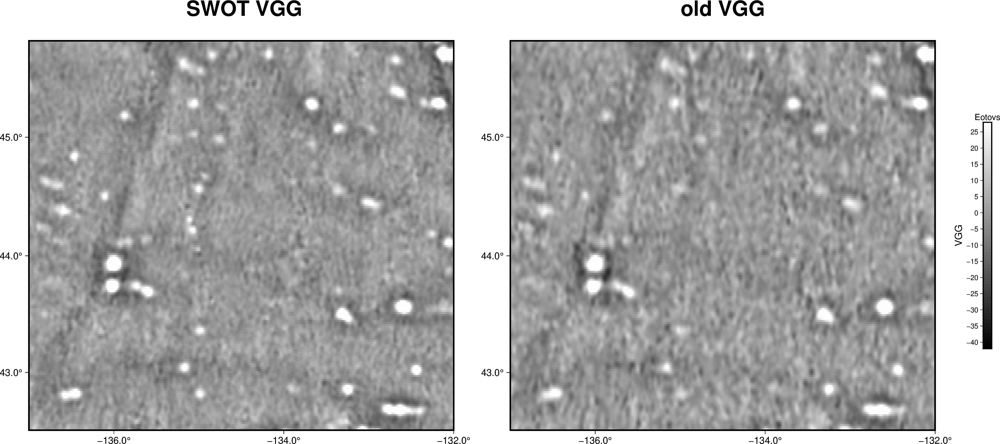

In [22]:
vgg_file = xr.open_dataset("/Volumes/envisat2/SWOT/src/sandwell/grid_swot/out_stack_plot/vgg_swot.grd")
topo_antarctic = topo_file.sel(lon=slice(-137, -132), lat=slice(41, 46.5))
old_vgg_antarctic = old_vgg_file.sel(lon=slice(-137, -132), lat=slice(41, 46.5))
vgg_antarctic = vgg_file.sel(lon=slice(-137, -132), lat=slice(41, 46.5))

shade_vgg = pygmt.grdgradient(grid=xr.DataArray(vgg_antarctic.z, coords=(vgg_antarctic.lat, vgg_antarctic.lon)), azimuth = 120, normalize="t.5")
fig = pygmt.Figure()
pygmt.config(FORMAT_GEO_MAP="ddd.x", MAP_FRAME_TYPE="plain")
pygmt.makecpt(cmap="gray", series=[-42, 28, 1], background='o')
fig.grdimage(
    grid = xr.DataArray(vgg_antarctic.z, coords=(vgg_antarctic.lat, vgg_antarctic.lon)),
    # shading = shade_vgg,
    projection="M15c",
    region = [-137, -132, 42.5, 45.8],
    frame=["WSrt+t SWOT VGG", "xa2", "ya1"],
    cmap = True,
    )
fig.coast(land="white")

fig.shift_origin(xshift="17c")
fig.grdimage(
    grid = xr.DataArray(old_vgg_antarctic.z, coords=(old_vgg_antarctic.lat, old_vgg_antarctic.lon)),
    # shading = shade_vgg,
    projection="M15c",
    region = [-137, -132, 42.5, 45.8],
    frame=["WSrt+told VGG", "xa2", "ya1"],
    cmap = True,
    )
fig.coast(land="white")
fig.colorbar(position="JML+o-17c/0c+w8c/0.3c", frame=["xa5f5+lVGG", "y+lEotovs"])

# fig.savefig("seamounts2.pdf", dpi=600)
fig.show()

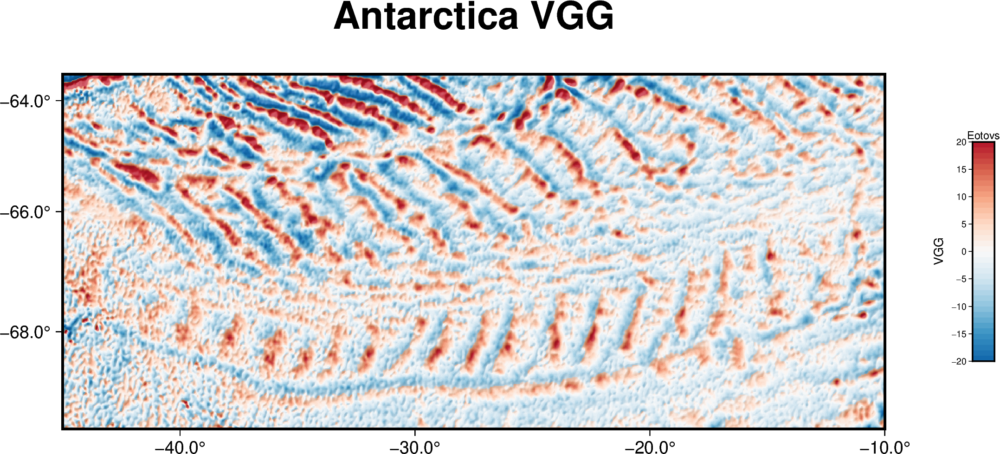

In [111]:
topo_antarctic = topo_file.sel(lon=slice(-45, -10), lat=slice(-72, -62))
vgg_antarctic = vgg_file.sel(lon=slice(-45, -10), lat=slice(-72, -62))

shade_vgg = pygmt.grdgradient(grid=xr.DataArray(vgg_antarctic.z, coords=(vgg_antarctic.lat, vgg_antarctic.lon)), azimuth = 120, normalize="t.5")
fig = pygmt.Figure()
pygmt.config(FORMAT_GEO_MAP="ddd.x", MAP_FRAME_TYPE="plain")
pygmt.makecpt(cmap="colors.cpt", series=[-20, 20, 1], background='o')
fig.grdimage(
    grid = xr.DataArray(vgg_file.z, coords=(vgg_file.lat, vgg_file.lon)),
    shading = shade_vgg,
    projection="M15c",
    region = [-45, -10, -69.5, -63.5],
    frame=["WSrt+tAntarctica VGG", "xa10", "ya2"],
    cmap = True,
    )

fig.coast(land="white")
fig.colorbar(position="JML+o-17c/0c+w4c/0.4c", frame=["xa5f5+lVGG", "y+lEotovs"])

fig.savefig("antarctica.png", dpi=300)
fig.show()

In [72]:
%%sh
gmt grdcut /Volumes/envisat2/SWOT/src/sandwell/grid_swot/SYNBATH_V2.0.nc -R-66/-53/-47.5/-40 -Gtopo_SA.grd


In [6]:
pygmt.grdfilter(
    grid="topo_SA.grd",
    filter="g20",
    distance="4",
    region=[-66, -53, -47.5, -40],
    spacing=0.02083333,
    outgrid="topo_smooth_SA.grd",
)

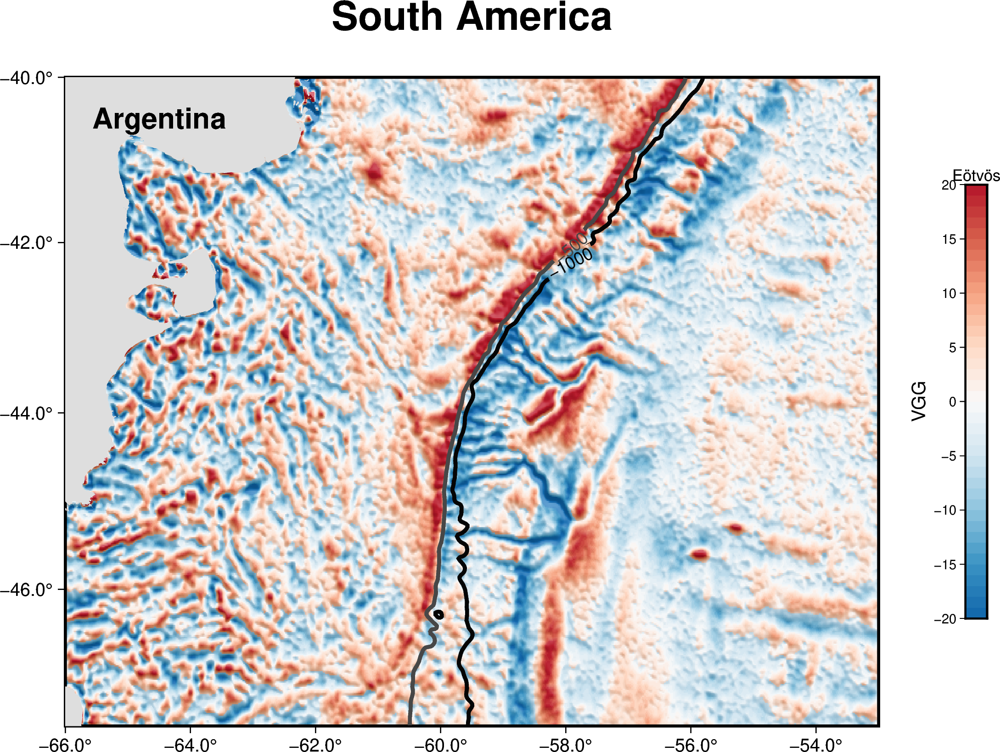

In [20]:
vgg_file = xr.open_dataset("vgg_smooth.grd")
# vgg_file = xr.open_dataset("/Volumes/envisat2/SWOT/src/sandwell/grid_swot/vgg_swot.grd")
# topo_sa = topo_file.sel(lon=slice(-66, -53), lat=slice(-47.5, -40))
topo_sa = xr.open_dataset("topo_smooth_SA.grd")
vgg_sa = vgg_file.sel(lon=slice(-66, -53), lat=slice(-47.5, -40))

shade_vgg = pygmt.grdgradient(grid=xr.DataArray(vgg_sa.z, coords=(vgg_sa.lat, vgg_sa.lon)), azimuth = 20, normalize="t.5")
fig = pygmt.Figure()
pygmt.config(FORMAT_GEO_MAP="ddd.x", MAP_FRAME_TYPE="plain")
pygmt.makecpt(cmap="colors.cpt", series=[-20, 20, 1], background='o')
fig.grdimage(
    grid = xr.DataArray(vgg_file.z, coords=(vgg_file.lat, vgg_file.lon)),
    shading = shade_vgg,
    projection="M15c",
    region = [-66, -53, -47.5, -40],
    frame=["WSrt+tSouth America", "xa2", "ya2"],
    cmap = True,
    )

fig.coast(land="222")
fig.text(x=-64.5, y=-40.5, text="Argentina", font="15p,Helvetica-Bold")


fig.colorbar(position="JML+o-17c/0c+w8c/0.4c", frame=["xa5f5+lVGG", "y+lEötvös"])

# fig.grdcontour(
#     grid=xr.DataArray(topo_sa.z, coords=(topo_sa.lat, topo_sa.lon)),
#     annotation=1000,
#     interval=1000,
#     pen = "2p,gray28", #-2000m
#     limit=[-2200, -1800],
# )
fig.grdcontour(
    grid=xr.DataArray(topo_sa.z, coords=(topo_sa.lat, topo_sa.lon)),
    annotation=1000,
    interval=500,
    pen = "2p,gray2", #-1000m
    limit=[-1200, -800],
)
fig.grdcontour(
    grid=xr.DataArray(topo_sa.z, coords=(topo_sa.lat, topo_sa.lon)),
    annotation=500,
    interval=500,
    pen = "2p,gray28", #-500m
    limit=[-600, -400],
)
fig.savefig("SAmerica.pdf", dpi=600)
fig.show()

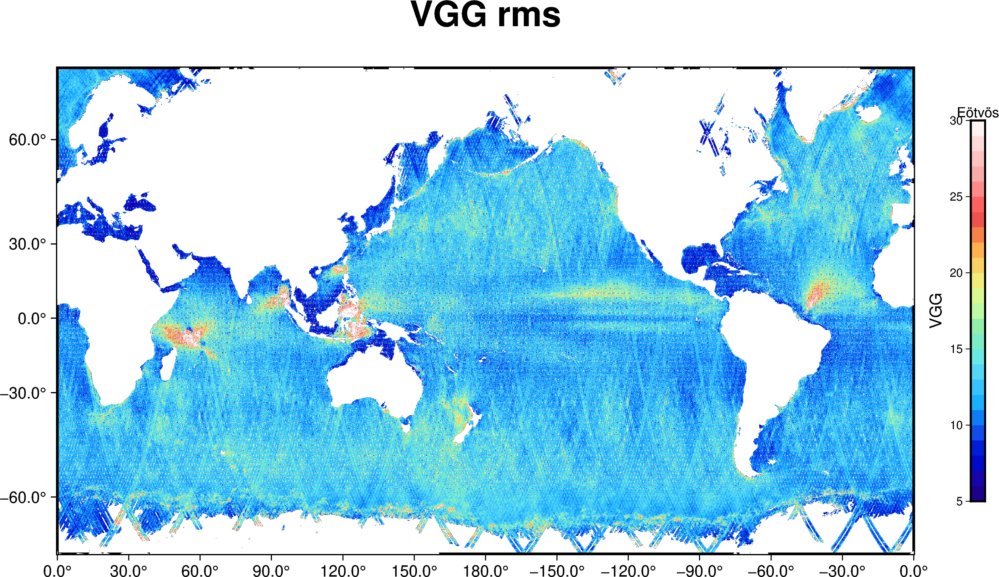

In [103]:
vgg_L3_file = xr.open_dataset("/Volumes/envisat2/SWOT/src/sandwell/grid_swot/out_stack_L3/vgg_swot.grd")
vgg_file = xr.open_dataset("/Volumes/envisat2/SWOT/src/sandwell/grid_swot/out_stack_mean/swot_vgg_rms.grd")

fig = pygmt.Figure()
pygmt.config(FORMAT_GEO_MAP="ddd.x", MAP_FRAME_TYPE="plain",COLOR_BACKGROUND = "white")

pygmt.makecpt(cmap="haxby", series=[5, 30, 1], background='i')
fig.grdimage(
    grid = xr.DataArray(vgg_file.z, coords=(vgg_file.lat, vgg_file.lon)),
    projection="M18c",
    # projection="J-65/12c", 
    region = [0, 360, -70, 72],
    frame=["WSrt+tVGG rms", "xa30", "ya30"],
    cmap = True,
    )
fig.coast(land="white")
fig.colorbar(position="JML+o-19.5c/0c+w8c/0.3c", frame=["xa5f5+lVGG", "y+lEötvös"])
fig.savefig("SWOT_L2_vgg_rms.pdf", dpi=300)
fig.show()

### read seamount catalogue

In [63]:
df_seamounts = pd.read_excel('sample_mask.txt.xlsx')

In [64]:
ship_seamounts = df_seamounts.loc[df_seamounts['Charted'] == 1]
# ship_seamounts = ship_seamounts.loc[ship_seamounts['surface_depth'] < 0]
# all_seamounts = df_seamounts.loc[df_seamounts['surface_depth'] < 0]
all_seamounts = df_seamounts

In [68]:
np.min(ship_height)

0.6

In [66]:
ship_height = ship_seamounts['VGG Height'].values / 1000.0
all_height = all_seamounts['VGG Height'].values/1000.0 # height in km

# a = (np.arange(100))*0.1+0.1
# bins_all = a.flatten().tolist()
bins_all=[0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 1.25, 1.5, 1.75, 2, 2.25, 2.5, 2.75, 3, 3.33, 3.66, 4,4.5, 5, 5.5, 6, 6.5, 7]

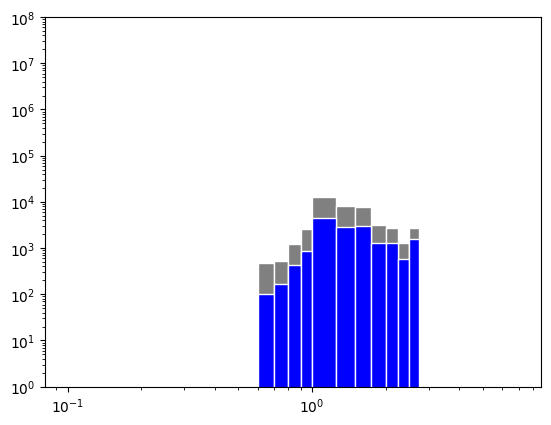

In [67]:
plt.figure()
plt.hist(all_height, bins=bins_all, edgecolor="white", color="gray") 
plt.hist(ship_height, bins=bins_all, edgecolor="white", color="blue") 

plt.xscale('log')
plt.yscale('log')
plt.ylim([1, 10**8])
plt.show()

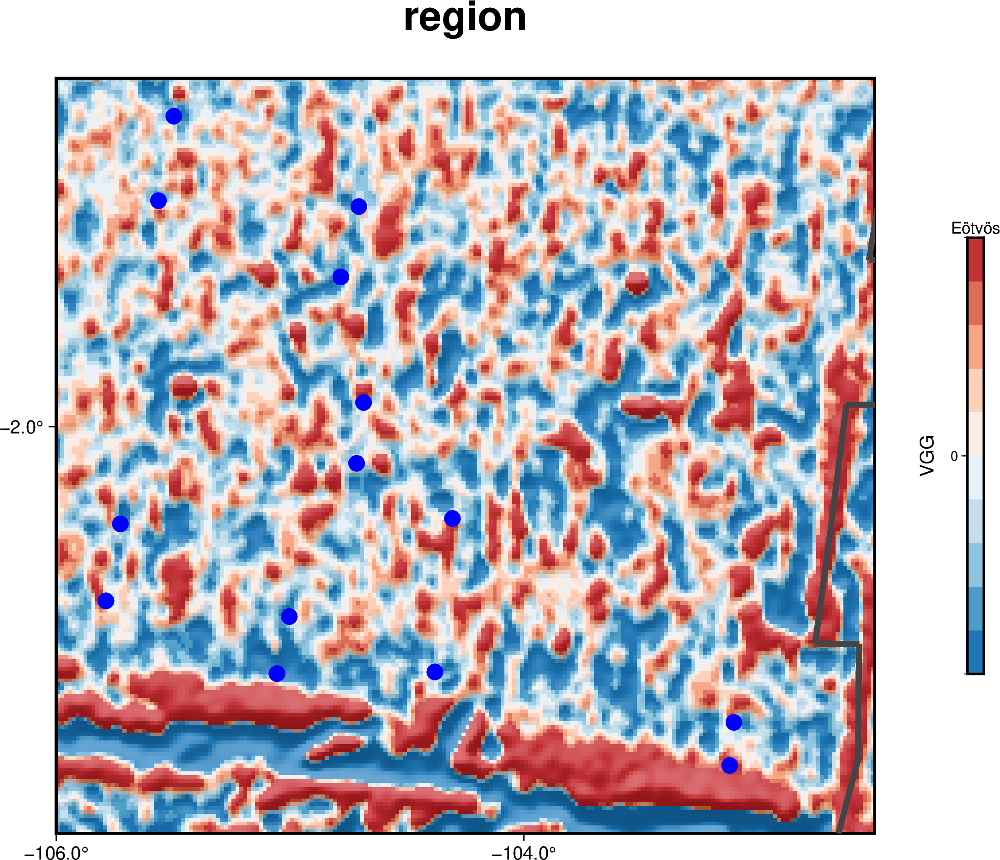

In [55]:
vgg_region = vgg_file.sel(lon=slice(-106, -102.5), lat=slice(-3.75, -0.5))
shade_vgg = pygmt.grdgradient(grid=xr.DataArray(vgg_region.z, coords=(vgg_region.lat, vgg_region.lon)), azimuth = 0, normalize="t.5")


fig = pygmt.Figure()
pygmt.config(FORMAT_GEO_MAP="ddd.x", MAP_FRAME_TYPE="plain")

fig.shift_origin(xshift="17c")
pygmt.makecpt(cmap="colors.cpt", series=[-5, 5, 1], background='o')
fig.grdimage(
    grid = xr.DataArray(vgg_region.z, coords=(vgg_region.lat, vgg_region.lon)),
    shading = shade_vgg,
    projection="M15c",
    region = [-106, -102.5, -3.75, -0.5],
    frame=["WSrt+tregion", "xa2", "ya2"],
    cmap = True,
    )
fig.plot(
    data = 'Plate_Interface.xyz',
    pen="3p,gray27,solid",
    )
fig.plot(
    data = '/Volumes/envisat/Users/yayu/Documents/python_codes/SWOT/L2_read/pick_abyssalhills/data/midpoints/global/EPR.xy',
     style="p0.3c", fill="blue"
    )

fig.colorbar(position="JML+o-17c/0c+w8c/0.3c", frame=["xa20f5+lVGG", "y+lEötvös"])
# fig.savefig("SWOT_Abyssal_hills.pdf", dpi=600)
fig.show()